# MMVCの学習に必要なconfig系Fileを作成する

ver.2022/06/19



## 1 概要
MMVC学習用の自身の音声データを録音します。

## 2 Google Drive をマウント
**Google Drive にアップロードした MMVC_Trainer を参照できるように、設定します。**

「このノートブックに Google ドライブのファイルへのアクセスを許可しますか？」

といったポップアップが表示されるので、「Google ドライブに接続」を押下し、google アカウントを選択して、「許可」を選択してください。

成功すれば、下記メッセージが出ます。
```
Mounted at /content/drive/
```


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


cdコマンドを実行して、マウントしたGoogle Drive のMMVC_Trainerディレクトリに移動します。

%cd 「MMVC_Trainerをgoogle driveにパップロードしたパス」

としてください。

正しいパスが指定されていれば

-rw------- 1 root root 11780 Mar  4 16:53 attentions.py

-rw------- 1 root root  4778 Mar  4 16:53 commons.py

drwx------ 2 root root  4096 Mar  5 15:20 configs

...といった感じに表示されるはずです。

In [ ]:
%cd /content/drive/MyDrive/Colab/MMVC_Trainer/
!ls -la

/content/drive/MyDrive/Colab/MMVC_Trainer
total 2627
-rw------- 1 root root   11780 Apr  8 09:50 attentions.py
-rw------- 1 root root    4778 Apr  8 09:50 commons.py
drwx------ 2 root root    4096 Apr  8 09:50 configs
-rw------- 1 root root    8636 Jul  3 00:30 create_dataset_jtalk.py
-rw------- 1 root root    3230 Apr  8 09:50 create_dataset_julius.py
drwx------ 3 root root    4096 Apr  8 09:50 dataset
-rw------- 1 root root   19707 Jun  2 08:42 data_utils.py
drwx------ 2 root root    4096 May  6 10:13 docs
-rw------- 1 root root     143 Jun  7 05:28 encoderのpadding影響度合い.gsheet
drwx------ 2 root root    4096 Apr  8 09:50 filelists
drwx------ 2 root root    4096 Apr  8 09:50 fine_model
drwx------ 2 root root    4096 Apr  8 09:50 .git
-rw------- 1 root root    1828 May 19 10:56 .gitignore
-rw------- 1 root root    2138 Apr  8 09:50 LICENSE
drwx------ 2 root root    4096 Apr 12 02:32 logs
-rw------- 1 root root    1314 Apr  8 09:50 losses.py
-rw------- 1 root root    3939 May 23 06:30 me

## 3 学習用音声を録音する

ITAコーパスを利用して音声を録音します。  
次の録音用のプログラムを読み込みます。

In [ ]:
# from https://gist.github.com/korakot/c21c3476c024ad6d56d5f48b0bca92be
# from https://colab.research.google.com/github/espnet/notebook/blob/master/espnet2_asr_realtime_demo.ipynb

from IPython.display import Javascript
from google.colab import output
from base64 import b64decode

RECORD = """
const sleep = time => new Promise(resolve => setTimeout(resolve, time))
const b2text = blob => new Promise(resolve => {
  const reader = new FileReader()
  reader.onloadend = e => resolve(e.srcElement.result)
  reader.readAsDataURL(blob)
})
var record = time => new Promise(async resolve => {
  stream = await navigator.mediaDevices.getUserMedia({ audio: true })
  recorder = new MediaRecorder(stream)
  chunks = []
  recorder.ondataavailable = e => chunks.push(e.data)
  recorder.start()
  await sleep(time)
  recorder.onstop = async ()=>{
    blob = new Blob(chunks)
    text = await b2text(blob)
    resolve(text)
  }
  recorder.stop()
})
"""

def record(sec, filename='audio.wav'):
  display(Javascript(RECORD))
  s = output.eval_js('record(%d)' % (sec * 1000))
  b = b64decode(s.split(',')[1])
  with open(filename, 'wb+') as f:
    f.write(b)

import librosa
import librosa.display
import matplotlib.pyplot as plt
import pysndfile
from IPython.display import display, Audio
import warnings
warnings.filterwarnings('ignore')

def rec(sec, filename, text, hira):
  myvoice_dir = "./dataset/textful/02_myvoice/wav/"
  sampling_rate = 24000
  if sec > 15 :
    print("15秒以上の音声は学習できません。\n録音秒数を15秒以下に指定してください。")
    return
  print(f"{text}\n{hira}")
  record(sec, "temp.wav")
  print("---終了---")
  speech, rate = librosa.load("temp.wav", sr=sampling_rate)
  speecht, index = librosa.effects.trim(speech, top_db=30)
  pysndfile.sndio.write(myvoice_dir + filename, speecht, rate=rate, format='wav', enc='pcm16')
  librosa.display.waveplot(speecht, sr=rate)
  plt.show()
  display(Audio(speecht, rate=rate))


以下の100件の学習データを録音します。  
実行したら話す内容が表示されるので「---終了---」と表示されるまでに録音してください。  
録音した波形が表示されるので、再生してみて良ければ次の録音をします。  
うまく録音できていなかったら再度実行して録音しなおしてください。  
時々録音状態が終了しない時があり、その際は左の■で止めて、ページ自体をスーパーリロード（shiftキーを押しながら再読み込み）してから再度実行してください。  
録音時間が短い場合、先頭「rec(5, …」などの「5」の部分が録音秒数になっているので、修正してください。ただしMMVCの最大学習時間が15秒となっているのでそれ以下に指定してください。  
学習データは MMVC_Trainer/dataset/textful/00_myvoice/wav/ 以下に保存されます。

えっ嘘でしょ。
えっうそでしょ。


<IPython.core.display.Javascript object>

---終了---


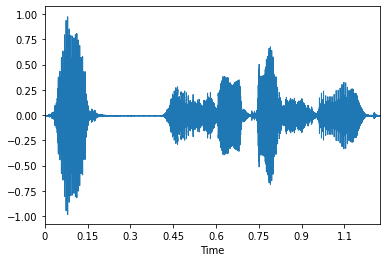

In [ ]:
rec(3, "emotion001.wav", "えっ嘘でしょ。", "えっうそでしょ。")

シュヴァイツァーは見習うべき人間です。
しゅゔぁいつぁーわみならうべきにんげんです。


<IPython.core.display.Javascript object>

---終了---


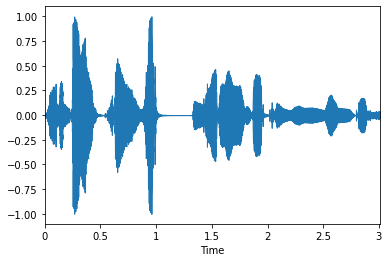

In [ ]:
rec(5, "emotion002.wav", "シュヴァイツァーは見習うべき人間です。", "しゅゔぁいつぁーわみならうべきにんげんです。")

デーヴィスさんはとても疲れているように見える。
でーゔぃすさんわとてもつかれているよーにみえる。


<IPython.core.display.Javascript object>

---終了---


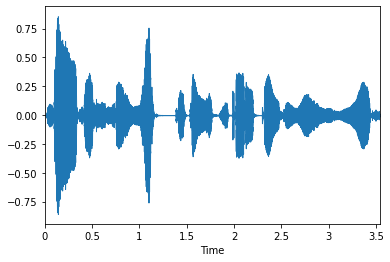

In [ ]:
rec(5, "emotion003.wav", "デーヴィスさんはとても疲れているように見える。", "でーゔぃすさんわとてもつかれているよーにみえる。")

スティーヴはジェーンから手紙をもらった。
すてぃーゔわじぇーんからてがみをもらった。


<IPython.core.display.Javascript object>

---終了---


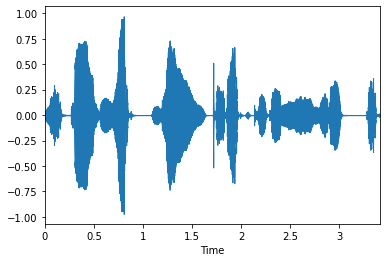

In [ ]:
rec(5, "emotion004.wav", "スティーヴはジェーンから手紙をもらった。", "すてぃーゔわじぇーんからてがみをもらった。")

彼女はモーツァルトやベートーヴェンといった、古典派の作曲家が好きだ。
かのじょわもーつぁるとやべーとーゔぇんといった、こてんはのさっきょくかがすきだ。


<IPython.core.display.Javascript object>

---終了---


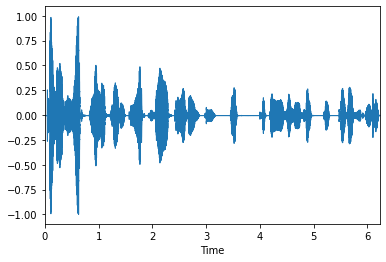

In [ ]:
rec(10, "emotion005.wav", "彼女はモーツァルトやベートーヴェンといった、古典派の作曲家が好きだ。", "かのじょわもーつぁるとやべーとーゔぇんといった、こてんはのさっきょくかがすきだ。")

ストラットフォード・オン・エイヴォンは、シェイクスピアの生まれたところですが
すとらっとふぉーどおんえいゔぉんわ、しぇいくすぴあのうまれたところですが


<IPython.core.display.Javascript object>

---終了---


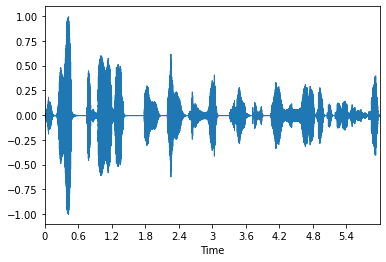

In [ ]:
rec(10, "emotion006-1.wav", "ストラットフォード・オン・エイヴォンは、シェイクスピアの生まれたところですが", "すとらっとふぉーどおんえいゔぉんわ、しぇいくすぴあのうまれたところですが")

毎年多くの観光客が訪れます。
まいとしおおくのかんこーきゃくがおとずれます。


<IPython.core.display.Javascript object>

---終了---


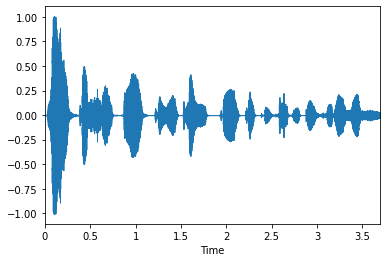

In [ ]:
rec(5, "emotion006-2.wav", "毎年多くの観光客が訪れます。", "まいとしおおくのかんこーきゃくがおとずれます。")

彼はピューマを慣らすのに、大いに骨を折った。
かれわぴゅーまをならすのに、おおいにほねをおった。


<IPython.core.display.Javascript object>

---終了---


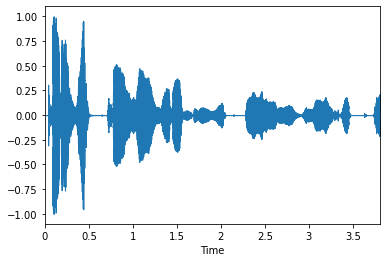

In [ ]:
rec(5, "emotion007.wav", "彼はピューマを慣らすのに、大いに骨を折った。", "かれわぴゅーまをならすのに、おおいにほねをおった。")

彼が解雇されるとは妙な話だ。
かれがかいこされるとわみょーなはなしだ。


<IPython.core.display.Javascript object>

---終了---


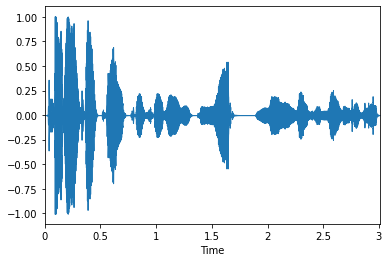

In [ ]:
rec(5, "emotion008.wav", "彼が解雇されるとは妙な話だ。", "かれがかいこされるとわみょーなはなしだ。")

クリスはヴァンパイア・ナイトを倒した。
くりすわゔぁんぱいあないとをたおした。


<IPython.core.display.Javascript object>

---終了---


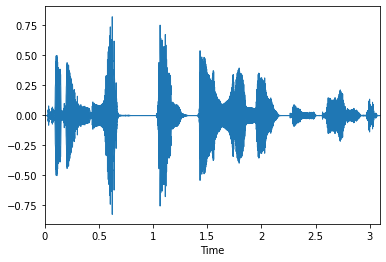

In [ ]:
rec(5, "emotion009.wav", "クリスはヴァンパイア・ナイトを倒した。", "くりすわゔぁんぱいあないとをたおした。")

彼のあだ名は言い得て妙だよね。
かれのあだなわいいえてみょーだよね。


<IPython.core.display.Javascript object>

---終了---


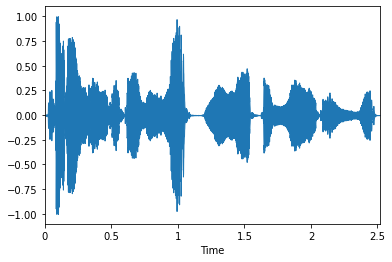

In [ ]:
rec(5, "emotion010.wav", "彼のあだ名は言い得て妙だよね。", "かれのあだなわいいえてみょーだよね。")

イタリア旅行で彼は、いくつか景勝の地として有名な都市
いたりありょこーでかれわ、いくつかけーしょーのちとしてゆうめーなとし


<IPython.core.display.Javascript object>

---終了---


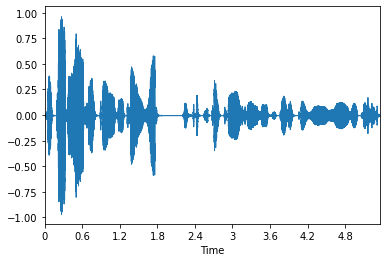

In [ ]:
rec(7, "emotion011-1.wav", "イタリア旅行で彼は、いくつか景勝の地として有名な都市", "いたりありょこーでかれわ、いくつかけーしょーのちとしてゆうめーなとし")

例えば、ナポリやフィレンツェを訪れた。
たとえば、なぽりやふぃれんつぇをおとずれた。


<IPython.core.display.Javascript object>

---終了---


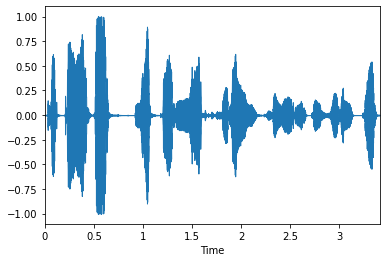

In [ ]:
rec(7, "emotion011-2.wav", "例えば、ナポリやフィレンツェを訪れた。", "たとえば、なぽりやふぃれんつぇをおとずれた。")

ゼロという概念は、ヒンドゥー文化に由来している。
ぜろとゆうがいねんわ、ひんどぅーぶんかにゆらいしている。


<IPython.core.display.Javascript object>

---終了---


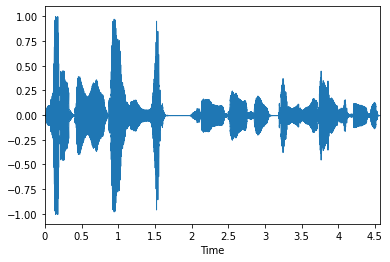

In [ ]:
rec(10, "emotion012.wav", "ゼロという概念は、ヒンドゥー文化に由来している。", "ぜろとゆうがいねんわ、ひんどぅーぶんかにゆらいしている。")

そのいたずら娘は何食わぬ顔をした。
そのいたずらむすめわなにくわぬかおをした。


<IPython.core.display.Javascript object>

---終了---


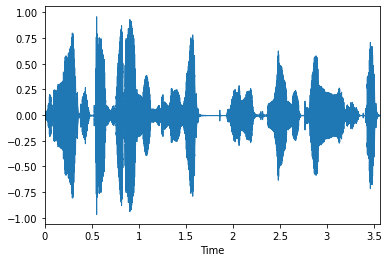

In [ ]:
rec(5, "emotion013.wav", "そのいたずら娘は何食わぬ顔をした。", "そのいたずらむすめわなにくわぬかおをした。")

スミスさん、ピエール・デュボワをご紹介しますわ。私の親友なの。
すみすさん、ぴえーるでゅぼわをごしょーかいしますわ。わたしのしんゆうなの。


<IPython.core.display.Javascript object>

---終了---


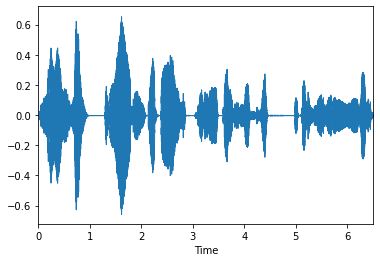

In [ ]:
rec(10, "emotion014.wav", "スミスさん、ピエール・デュボワをご紹介しますわ。私の親友なの。", "すみすさん、ぴえーるでゅぼわをごしょーかいしますわ。わたしのしんゆうなの。")

どーすんの、このお店。完ッ全に閑古鳥が鳴いちゃってるじゃない。
どーすんの、このおみせ。かんっぜんにかんこどりがないちゃってるじゃない。


<IPython.core.display.Javascript object>

---終了---


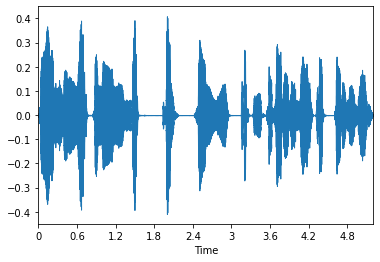

In [ ]:
rec(10, "emotion015.wav", "どーすんの、このお店。完ッ全に閑古鳥が鳴いちゃってるじゃない。", "どーすんの、このおみせ。かんっぜんにかんこどりがないちゃってるじゃない。")

頂上に着くと皆でヤッホーと叫んだ。
ちょーじょーにつくとみんなでやっほーとさけんだ。


<IPython.core.display.Javascript object>

---終了---


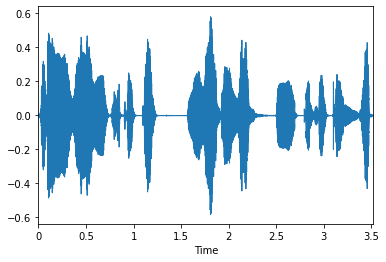

In [ ]:
rec(5, "emotion016.wav", "頂上に着くと皆でヤッホーと叫んだ。", "ちょーじょーにつくとみんなでやっほーとさけんだ。")

あっベルが鳴ってる。
あっべるがなってる。


<IPython.core.display.Javascript object>

---終了---


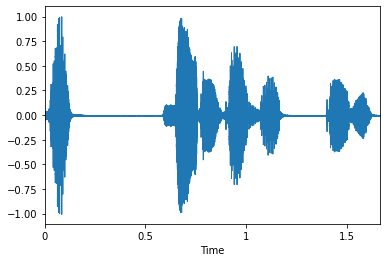

In [ ]:
rec(5, "emotion017.wav", "あっベルが鳴ってる。", "あっべるがなってる。")

彼女は彼にぴょこんとおじぎをした。
かのじょわかれにぴょこんとおじぎをした。


<IPython.core.display.Javascript object>

---終了---


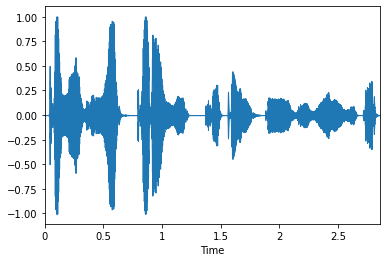

In [ ]:
rec(5, "emotion018.wav", "彼女は彼にぴょこんとおじぎをした。", "かのじょわかれにぴょこんとおじぎをした。")

男子生徒のめいめいが、帽子に学校のバッジをつけています。
だんしせーとのめーめーが、ぼーしにがっこーのばっじをつけています。


<IPython.core.display.Javascript object>

---終了---


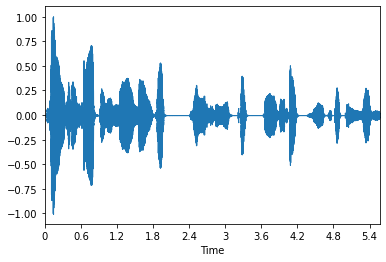

In [ ]:
rec(7, "emotion019.wav", "男子生徒のめいめいが、帽子に学校のバッジをつけています。", "だんしせーとのめーめーが、ぼーしにがっこーのばっじをつけています。")

ヒューズが飛んだ。
ひゅーずがとんだ。


<IPython.core.display.Javascript object>

---終了---


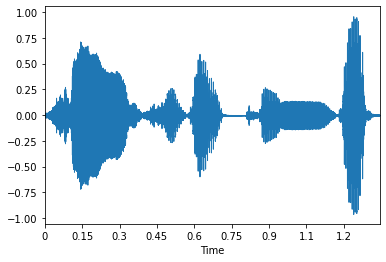

In [ ]:
rec(3, "emotion020.wav", "ヒューズが飛んだ。", "ひゅーずがとんだ。")

私はポピュラー音楽を聞きたい。
わたしわぽぴゅらーおんがくをききたい。


<IPython.core.display.Javascript object>

---終了---


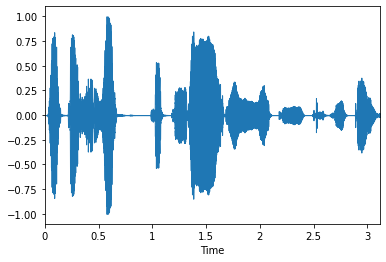

In [ ]:
rec(5, "emotion021.wav", "私はポピュラー音楽を聞きたい。", "わたしわぽぴゅらーおんがくをききたい。")

猫はにゃーにゃーと鳴く。
ねこわにゃーにゃーとなく。


<IPython.core.display.Javascript object>

---終了---


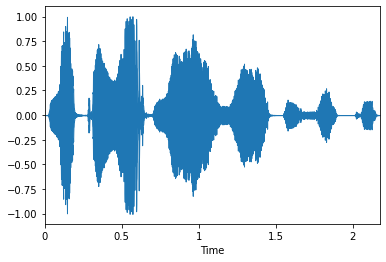

In [ ]:
rec(5, "emotion022.wav", "猫はにゃーにゃーと鳴く。", "ねこわにゃーにゃーとなく。")

私の一番上の兄が父の名代としてその会合に出席した。
わたしのいちばんうえのあにがちちのみょーだいとしてそのかいごーにしゅっせきした。


<IPython.core.display.Javascript object>

---終了---


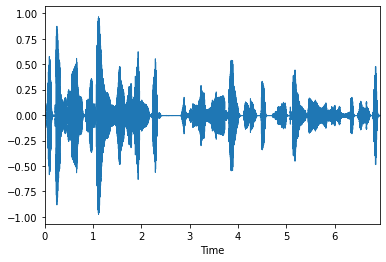

In [ ]:
rec(10, "emotion023.wav", "私の一番上の兄が父の名代としてその会合に出席した。", "わたしのいちばんうえのあにがちちのみょーだいとしてそのかいごーにしゅっせきした。")

彼は首相にインタビューした。
かれわしゅしょーにいんたびゅーした。


<IPython.core.display.Javascript object>

---終了---


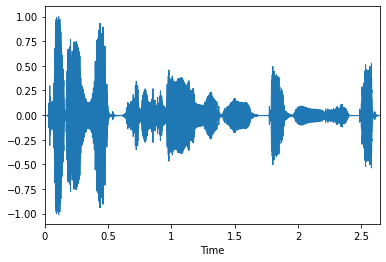

In [ ]:
rec(5, "emotion024.wav", "彼は首相にインタビューした。", "かれわしゅしょーにいんたびゅーした。")

その会社の急速な成長は、その独特な戦略によるものだった。
そのかいしゃのきゅうそくなせーちょーわ、そのどくとくなせんりゃくによるものだった。


<IPython.core.display.Javascript object>

---終了---


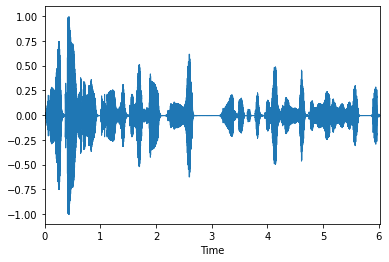

In [ ]:
rec(10, "emotion025.wav", "その会社の急速な成長は、その独特な戦略によるものだった。", "そのかいしゃのきゅうそくなせーちょーわ、そのどくとくなせんりゃくによるものだった。")

私はいつもミネラルウォーターを持ち歩いています。
わたしわいつもみねらるうぉーたーをもちあるいています。


<IPython.core.display.Javascript object>

---終了---


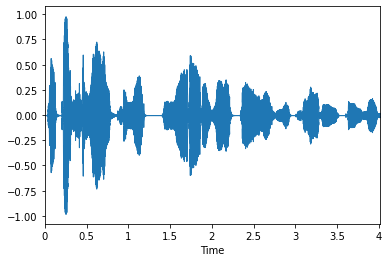

In [ ]:
rec(7, "emotion026.wav", "私はいつもミネラルウォーターを持ち歩いています。", "わたしわいつもみねらるうぉーたーをもちあるいています。")

彼女はハンドバッグを開けて家の鍵を探してみたが、見つからなかった。
かのじょわはんどばっぐをあけていえのかぎをさがしてみたが、みつからなかった。


<IPython.core.display.Javascript object>

---終了---


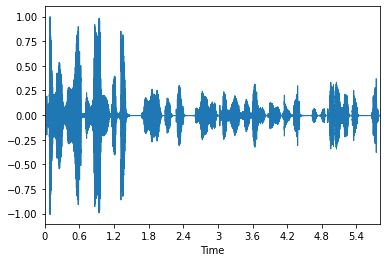

In [ ]:
rec(10, "emotion027.wav", "彼女はハンドバッグを開けて家の鍵を探してみたが、見つからなかった。", "かのじょわはんどばっぐをあけていえのかぎをさがしてみたが、みつからなかった。")

彼女はスタッフをまとめていけると思いますか？
かのじょわすたっふをまとめていけるとおもいますか？


<IPython.core.display.Javascript object>

---終了---


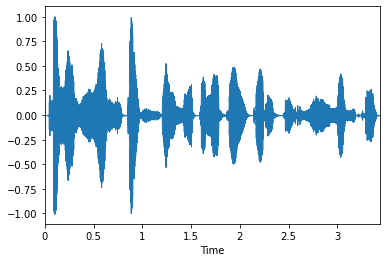

In [ ]:
rec(7, "emotion028.wav", "彼女はスタッフをまとめていけると思いますか？", "かのじょわすたっふをまとめていけるとおもいますか？")

牛乳はあなたの体に良いだろう、毎日飲んだほうがいい。
ぎゅうにゅうわあなたのからだによいだろー、まいにちのんだほーがいい。


<IPython.core.display.Javascript object>

---終了---


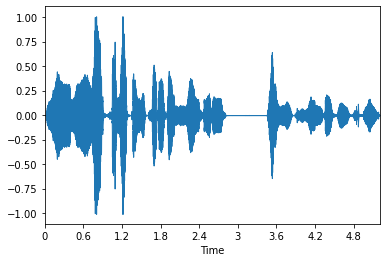

In [ ]:
rec(10, "emotion029.wav", "牛乳はあなたの体に良いだろう、毎日飲んだほうがいい。", "ぎゅうにゅうわあなたのからだによいだろー、まいにちのんだほーがいい。")

あなたは流感になりかけているか、もっと重い病気かもしれません。
あなたわりゅうかんになりかけているか、もっとおもいびょーきかもしれません。


<IPython.core.display.Javascript object>

---終了---


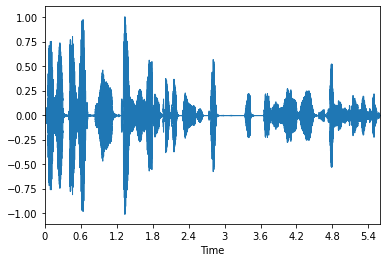

In [ ]:
rec(10, "emotion030.wav", "あなたは流感になりかけているか、もっと重い病気かもしれません。", "あなたわりゅうかんになりかけているか、もっとおもいびょーきかもしれません。")

彼女はその事件を、生き生きとした筆致で描写した。
かのじょわそのじけんを、いきいきとしたひっちでびょーしゃした。


<IPython.core.display.Javascript object>

---終了---


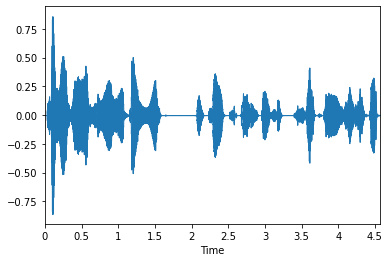

In [ ]:
rec(10, "emotion031.wav", "彼女はその事件を、生き生きとした筆致で描写した。", "かのじょわそのじけんを、いきいきとしたひっちでびょーしゃした。")

彼は自らの生涯を、インドでの病人の治療に捧げるつもりだ。
かれわみずからのしょーがいを、いんどでのびょーにんのちりょーにささげるつもりだ。


<IPython.core.display.Javascript object>

---終了---


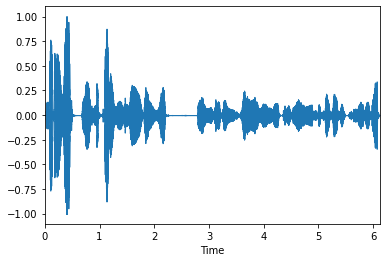

In [ ]:
rec(10, "emotion032.wav", "彼は自らの生涯を、インドでの病人の治療に捧げるつもりだ。", "かれわみずからのしょーがいを、いんどでのびょーにんのちりょーにささげるつもりだ。")

奇妙な男で、彼は人から話し掛けられないと口をきかない。
きみょーなおとこで、かれわひとからはなしかけられないとくちをきかない。


<IPython.core.display.Javascript object>

---終了---


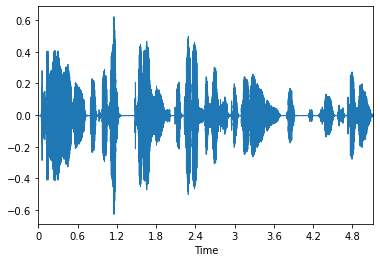

In [ ]:
rec(10, "emotion033.wav", "奇妙な男で、彼は人から話し掛けられないと口をきかない。", "きみょーなおとこで、かれわひとからはなしかけられないとくちをきかない。")

我々はその山脈で土着のガイドを雇った。
われわれわそのさんみゃくでどちゃくのがいどをやとった。


<IPython.core.display.Javascript object>

---終了---


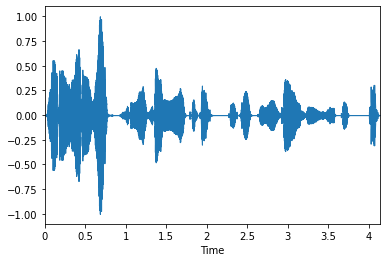

In [ ]:
rec(7, "emotion034.wav", "我々はその山脈で土着のガイドを雇った。", "われわれわそのさんみゃくでどちゃくのがいどをやとった。")

彼女は息子に家で行儀よくするように言った。
かのじょわむすこにいえでぎょーぎよくするよーにいった。


<IPython.core.display.Javascript object>

---終了---


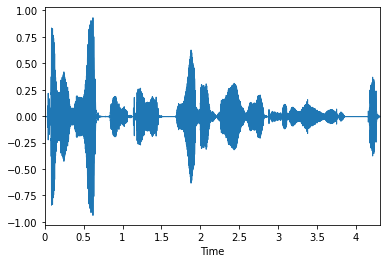

In [ ]:
rec(7, "emotion035.wav", "彼女は息子に家で行儀よくするように言った。", "かのじょわむすこにいえでぎょーぎよくするよーにいった。")

彼はライフルを拾い上げ、それで標的をねらった。
かれわらいふるをひろいあげ、それでひょーてきをねらった。


<IPython.core.display.Javascript object>

---終了---


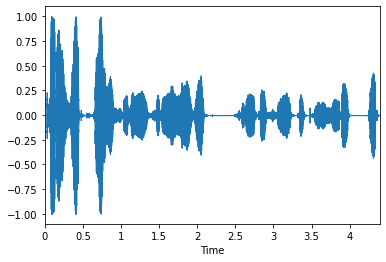

In [ ]:
rec(7, "emotion036.wav", "彼はライフルを拾い上げ、それで標的をねらった。", "かれわらいふるをひろいあげ、それでひょーてきをねらった。")

私はこの本に八百円を払った。
わたしわこのほんにはっぴゃくえんをはらった。


<IPython.core.display.Javascript object>

---終了---


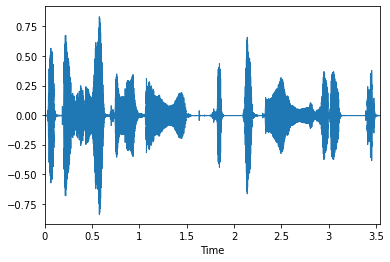

In [ ]:
rec(5, "emotion037.wav", "私はこの本に八百円を払った。", "わたしわこのほんにはっぴゃくえんをはらった。")

気分が悪くて入院したが、結果的にはたいしたことはなかった。
きぶんがわるくてにゅういんしたが、けっかてきにわたいしたことわなかった。


<IPython.core.display.Javascript object>

---終了---


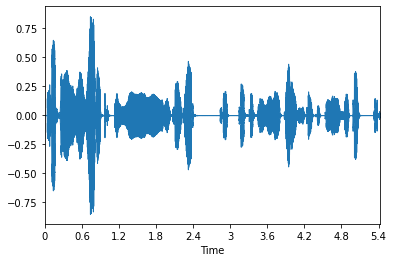

In [ ]:
rec(10, "emotion038.wav", "気分が悪くて入院したが、結果的にはたいしたことはなかった。", "きぶんがわるくてにゅういんしたが、けっかてきにわたいしたことわなかった。")

アフィ狙いの釣り記事ですね。
あふぃねらいのつりきじですね。


<IPython.core.display.Javascript object>

---終了---


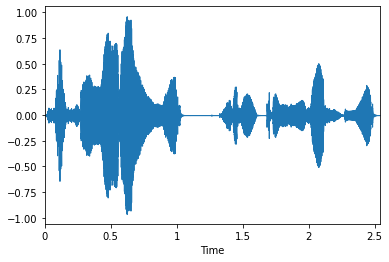

In [ ]:
rec(5, "emotion039-1.wav", "アフィ狙いの釣り記事ですね。", "あふぃねらいのつりきじですね。")

英語関係のコミュのあちこちにマルチポストしています。
えーごかんけーのこみゅのあちこちにまるちぽすとしています。


<IPython.core.display.Javascript object>

---終了---


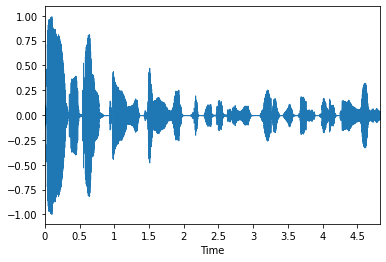

In [ ]:
rec(10, "emotion039-2.wav", "英語関係のコミュのあちこちにマルチポストしています。", "えーごかんけーのこみゅのあちこちにまるちぽすとしています。")

トラベラーズチェックを現金に替えてくれるのはこの窓口ですか？
とらべらーずちぇっくをげんきんにかえてくれるのわこのまどぐちですか？


<IPython.core.display.Javascript object>

---終了---


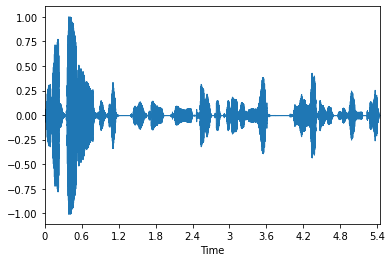

In [ ]:
rec(10, "emotion040.wav", "トラベラーズチェックを現金に替えてくれるのはこの窓口ですか？", "とらべらーずちぇっくをげんきんにかえてくれるのわこのまどぐちですか？")

本日の映画は、サウンド・オブ・ミュージックでございます。
ほんじつのえーがわ、さうんどおぶみゅーじっくでございます。


<IPython.core.display.Javascript object>

---終了---


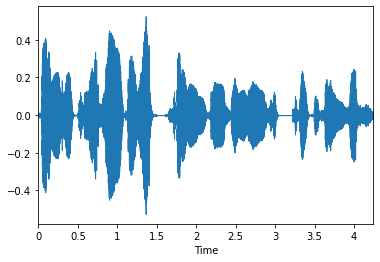

In [ ]:
rec(7, "emotion041.wav", "本日の映画は、サウンド・オブ・ミュージックでございます。", "ほんじつのえーがわ、さうんどおぶみゅーじっくでございます。")

概してわれわれ日本人は、外国語を話すのに少し臆病すぎる。
がいしてわれわれにほんじんわ、がいこくごをはなすのにすこしおくびょーすぎる。


<IPython.core.display.Javascript object>

---終了---


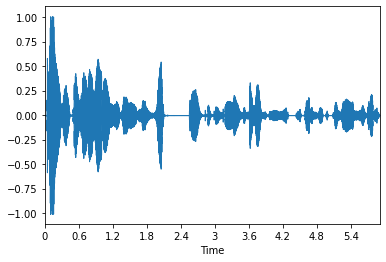

In [ ]:
rec(10, "emotion042.wav", "概してわれわれ日本人は、外国語を話すのに少し臆病すぎる。", "がいしてわれわれにほんじんわ、がいこくごをはなすのにすこしおくびょーすぎる。")

店の人は私のことを知るようになり
みせのひとわわたしのことをしるよーになり


<IPython.core.display.Javascript object>

---終了---


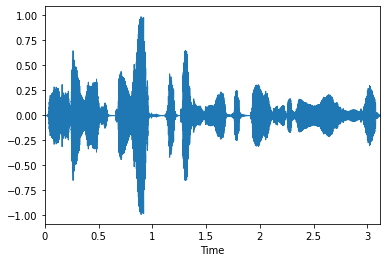

In [ ]:
rec(5, "emotion043-1.wav", "店の人は私のことを知るようになり", "みせのひとわわたしのことをしるよーになり")

私はいつも同じウェイトレスに応対してもらっていた。
わたしわいつもおなじうぇいとれすにおーたいしてもらっていた。


<IPython.core.display.Javascript object>

---終了---


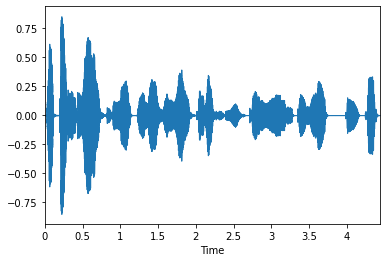

In [ ]:
rec(7, "emotion043-2.wav", "私はいつも同じウェイトレスに応対してもらっていた。", "わたしわいつもおなじうぇいとれすにおーたいしてもらっていた。")

この丘からは何百万という星が見える。
このおかからわなんびゃくまんとゆうほしがみえる。


<IPython.core.display.Javascript object>

---終了---


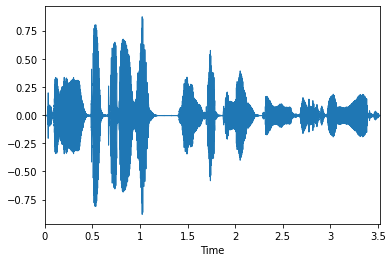

In [ ]:
rec(5, "emotion044.wav", "この丘からは何百万という星が見える。", "このおかからわなんびゃくまんとゆうほしがみえる。")

彼女は大学に入学したら、親から経済的に独立しようと思っていた。
かのじょわだいがくににゅうがくしたら、おやからけーざいてきにどくりつしよーとおもっていた。


<IPython.core.display.Javascript object>

---終了---


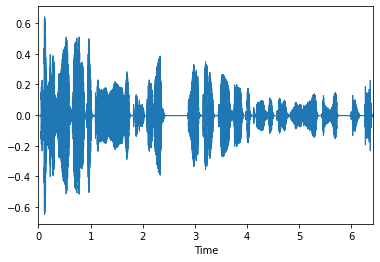

In [ ]:
rec(10, "emotion045.wav", "彼女は大学に入学したら、親から経済的に独立しようと思っていた。", "かのじょわだいがくににゅうがくしたら、おやからけーざいてきにどくりつしよーとおもっていた。")

サブマリンのペリスコープが、水中からにょっきり突き出ていた。
さぶまりんのぺりすこーぷが、すいちゅうからにょっきりつきでていた。


<IPython.core.display.Javascript object>

---終了---


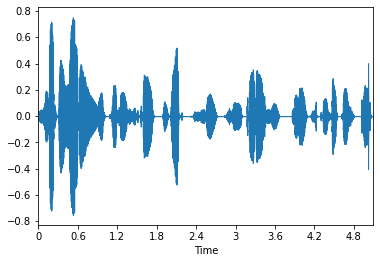

In [ ]:
rec(7, "emotion046.wav", "サブマリンのペリスコープが、水中からにょっきり突き出ていた。", "さぶまりんのぺりすこーぷが、すいちゅうからにょっきりつきでていた。")

別にブルマに特別な関心があるわけじゃない。
べつにぶるまにとくべつなかんしんがあるわけじゃない。


<IPython.core.display.Javascript object>

---終了---


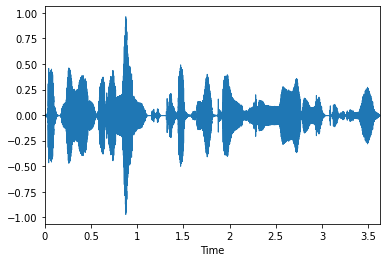

In [ ]:
rec(7, "emotion047.wav", "別にブルマに特別な関心があるわけじゃない。", "べつにぶるまにとくべつなかんしんがあるわけじゃない。")

そういうフェティシズムはないと思う。
そーゆうふぇてぃしずむわないとおもう。


<IPython.core.display.Javascript object>

---終了---


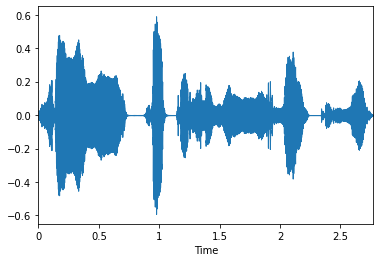

In [ ]:
rec(5, "emotion048.wav", "そういうフェティシズムはないと思う。", "そーゆうふぇてぃしずむわないとおもう。")

ウッド夫人が作ってくれるおいしい田舎風の料理を食べたし
うっどふじんがつくってくれるおいしいいなかふうのりょーりをたべたし


<IPython.core.display.Javascript object>

---終了---


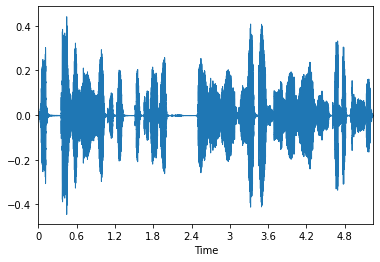

In [ ]:
rec(7, "emotion049-1.wav", "ウッド夫人が作ってくれるおいしい田舎風の料理を食べたし", "うっどふじんがつくってくれるおいしいいなかふうのりょーりをたべたし")

ミルクをたくさん飲みました。
みるくをたくさんのみました。


<IPython.core.display.Javascript object>

---終了---


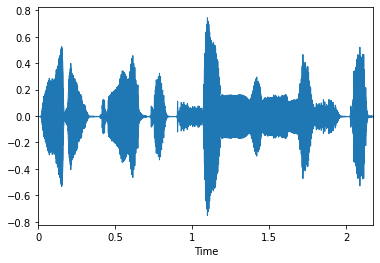

In [ ]:
rec(5, "emotion049-2.wav", "ミルクをたくさん飲みました。", "みるくをたくさんのみました。")

私の妻が瓶をわってしまったので
わたしのつまがびんをわってしまったので


<IPython.core.display.Javascript object>

---終了---


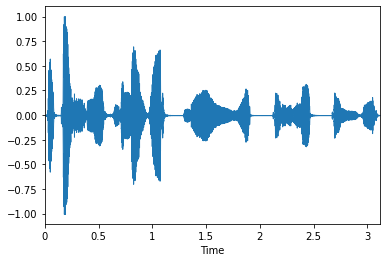

In [ ]:
rec(7, "emotion050-1.wav", "私の妻が瓶をわってしまったので", "わたしのつまがびんをわってしまったので")

台所の床は牛乳だらけになっている。
だいどころのゆかわぎゅうにゅうだらけになっている。


<IPython.core.display.Javascript object>

---終了---


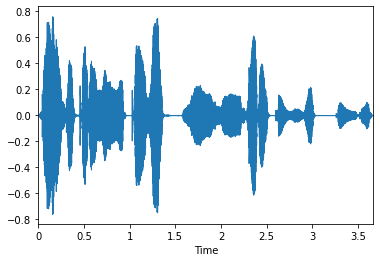

In [ ]:
rec(7, "emotion050-2.wav", "台所の床は牛乳だらけになっている。", "だいどころのゆかわぎゅうにゅうだらけになっている。")

喧嘩をしていた二人の子供は、お互いにしかめっ面をして座っていた。
けんかをしていたふたりのこどもわ、おたがいにしかめっつらをしてすわっていた。


<IPython.core.display.Javascript object>

---終了---


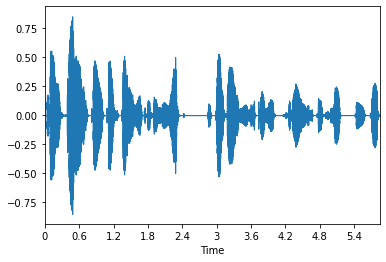

In [ ]:
rec(10, "emotion051.wav", "喧嘩をしていた二人の子供は、お互いにしかめっ面をして座っていた。", "けんかをしていたふたりのこどもわ、おたがいにしかめっつらをしてすわっていた。")

事業を継続しながら、事業が依拠している不動産を
じぎょーをけーぞくしながら、じぎょーがいきょしているふどーさんを


<IPython.core.display.Javascript object>

---終了---


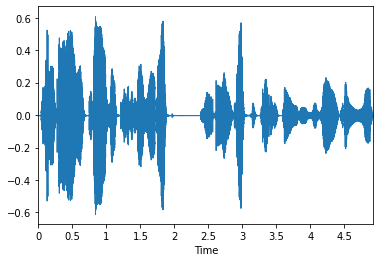

In [ ]:
rec(7, "emotion052-1.wav", "事業を継続しながら、事業が依拠している不動産を", "じぎょーをけーぞくしながら、じぎょーがいきょしているふどーさんを")

切り売りしていくことなど非現実的なのだ。
きりうりしていくことなどひげんじつてきなのだ。


<IPython.core.display.Javascript object>

---終了---


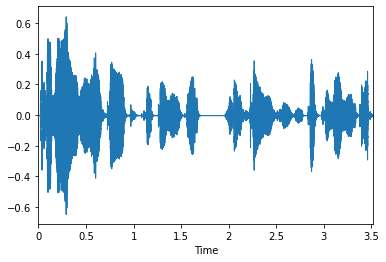

In [ ]:
rec(7, "emotion052-2.wav", "切り売りしていくことなど非現実的なのだ。", "きりうりしていくことなどひげんじつてきなのだ。")

しかしペパーバーグは、そのオウムを研究することによって
しかしぺぱーばーぐわ、そのおーむをけんきゅうすることによって


<IPython.core.display.Javascript object>

---終了---


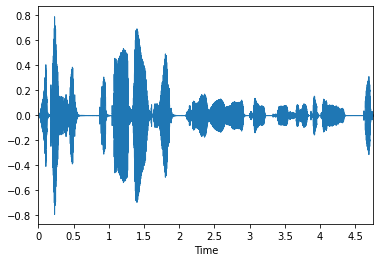

In [ ]:
rec(7, "emotion053-1.wav", "しかしペパーバーグは、そのオウムを研究することによって", "しかしぺぱーばーぐわ、そのおーむをけんきゅうすることによって")

動物に対する考え方が変わったと言っている。
どーぶつにたいするかんがえかたがかわったといっている。


<IPython.core.display.Javascript object>

---終了---


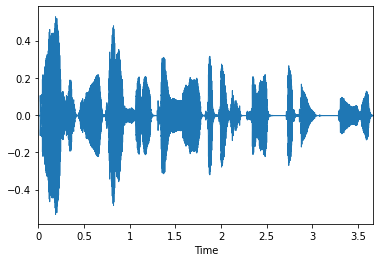

In [ ]:
rec(7, "emotion053-2.wav", "動物に対する考え方が変わったと言っている。", "どーぶつにたいするかんがえかたがかわったといっている。")

パックマンがある条件を満たすと、追ってくるモンスターを逆襲して食べることができる。
ぱっくまんがあるじょーけんをみたすと、おってくるもんすたーをぎゃくしゅうしてたべることができる。


<IPython.core.display.Javascript object>

---終了---


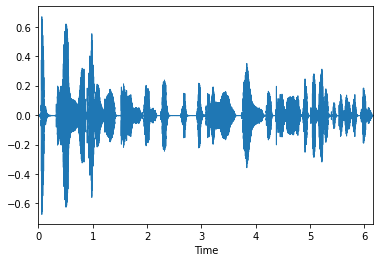

In [ ]:
rec(10, "emotion054.wav", "パックマンがある条件を満たすと、追ってくるモンスターを逆襲して食べることができる。", "ぱっくまんがあるじょーけんをみたすと、おってくるもんすたーをぎゃくしゅうしてたべることができる。")

その数百年後に、フォークが西洋のテーブルに現れることになるが
そのすうひゃくねんごに、ふぉーくがせーよーのてーぶるにあらわれることになるが


<IPython.core.display.Javascript object>

---終了---


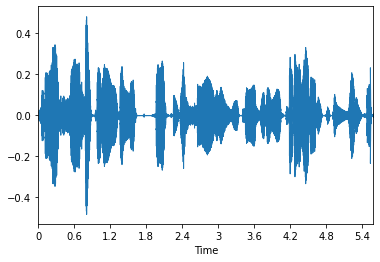

In [ ]:
rec(7, "emotion055-1.wav", "その数百年後に、フォークが西洋のテーブルに現れることになるが", "そのすうひゃくねんごに、ふぉーくがせーよーのてーぶるにあらわれることになるが")

ただちに受け入れられたわけではなかった。
ただちにうけいれられたわけでわなかった。


<IPython.core.display.Javascript object>

---終了---


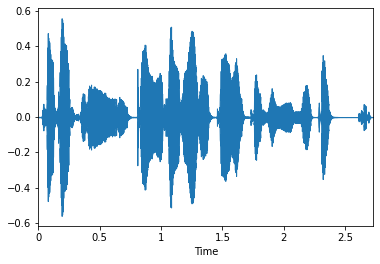

In [ ]:
rec(5, "emotion055-2.wav", "ただちに受け入れられたわけではなかった。", "ただちにうけいれられたわけでわなかった。")

トップのリーダーは犬の行動学ではアルファと呼ばれ、以下ベータ、ガンマと続きます。
とっぷのりーだーわいぬのこーどーがくでわあるふぁとよばれ、いかべーた、がんまとつづきます。


<IPython.core.display.Javascript object>

---終了---


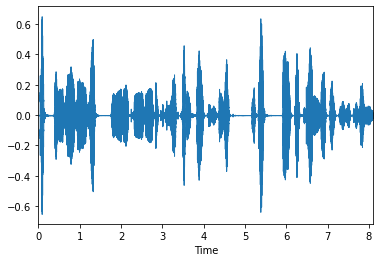

In [ ]:
rec(10, "emotion056.wav", "トップのリーダーは犬の行動学ではアルファと呼ばれ、以下ベータ、ガンマと続きます。", "とっぷのりーだーわいぬのこーどーがくでわあるふぁとよばれ、いかべーた、がんまとつづきます。")

ウィーンまでは歩くとどのくらいかかりますか？
うぃーんまでわあるくとどのくらいかかりますか？


<IPython.core.display.Javascript object>

---終了---


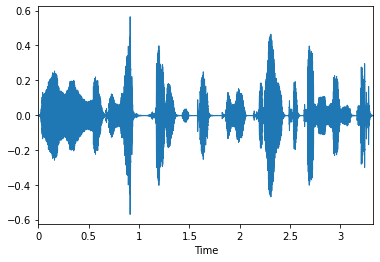

In [ ]:
rec(7, "emotion057.wav", "ウィーンまでは歩くとどのくらいかかりますか？", "うぃーんまでわあるくとどのくらいかかりますか？")

すみません、この辺に詳しくないんです。
すみません、このへんにくわしくないんです。


<IPython.core.display.Javascript object>

---終了---


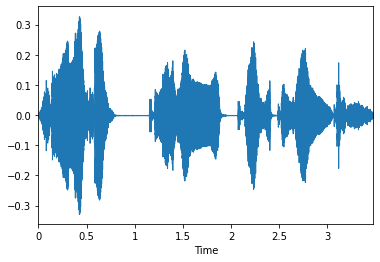

In [ ]:
rec(5, "emotion058.wav", "すみません、この辺に詳しくないんです。", "すみません、このへんにくわしくないんです。")

目標は授業設計をするときの、学生の思考を触発するメディア教材の選択および
もくひょーわじゅぎょーせっけーをするときの、がくせーのしこーをしょくはつするめでぃあきょーざいのせんたくおよび


<IPython.core.display.Javascript object>

---終了---


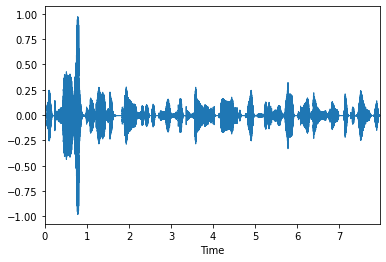

In [ ]:
rec(10, "emotion059-1.wav", "目標は授業設計をするときの、学生の思考を触発するメディア教材の選択および", "もくひょーわじゅぎょーせっけーをするときの、がくせーのしこーをしょくはつするめでぃあきょーざいのせんたくおよび")

活用方法について理解することである。
かつよーほーほーについてりかいすることである。


<IPython.core.display.Javascript object>

---終了---


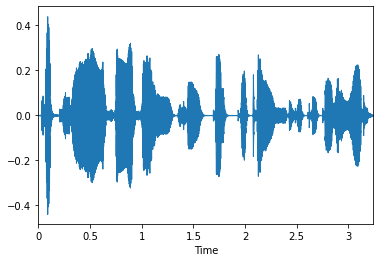

In [ ]:
rec(5, "emotion059-2.wav", "活用方法について理解することである。", "かつよーほーほーについてりかいすることである。")

とりあえず店の前、掃除しといてくれ。打ち水も頼む。
とりあえずみせのまえ、そーじしといてくれ。うちみずもたのむ。


<IPython.core.display.Javascript object>

---終了---


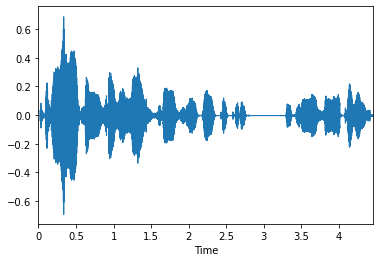

In [ ]:
rec(10, "emotion060.wav", "とりあえず店の前、掃除しといてくれ。打ち水も頼む。", "とりあえずみせのまえ、そーじしといてくれ。うちみずもたのむ。")

人々はトーナメントが始まる何ヶ月も前に、これらの入場券を買う。
ひとびとわとーなめんとがはじまるなんかげつもまえに、これらのにゅうじょーけんをかう。


<IPython.core.display.Javascript object>

---終了---


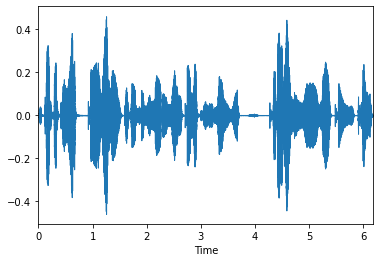

In [ ]:
rec(10, "emotion061.wav", "人々はトーナメントが始まる何ヶ月も前に、これらの入場券を買う。", "ひとびとわとーなめんとがはじまるなんかげつもまえに、これらのにゅうじょーけんをかう。")

彼女の魅力は言葉では表現できない、とその芸術家は叫んだ。
かのじょのみりょくわことばでわひょーげんできない、とそのげーじゅつかわさけんだ。


<IPython.core.display.Javascript object>

---終了---


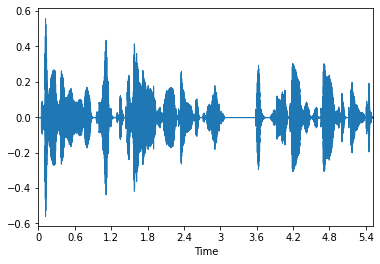

In [ ]:
rec(10, "emotion062.wav", "彼女の魅力は言葉では表現できない、とその芸術家は叫んだ。", "かのじょのみりょくわことばでわひょーげんできない、とそのげーじゅつかわさけんだ。")

事象として簡単なことを、いかにも難しそうに表現する人は
じしょーとしてかんたんなことを、いかにもむずかしそーにひょーげんするひとわ


<IPython.core.display.Javascript object>

---終了---


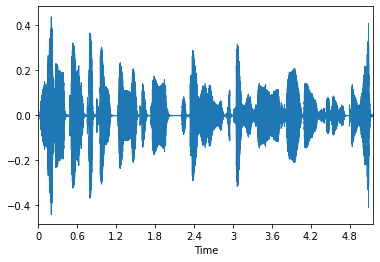

In [ ]:
rec(10, "emotion063-1.wav", "事象として簡単なことを、いかにも難しそうに表現する人は", "じしょーとしてかんたんなことを、いかにもむずかしそーにひょーげんするひとわ")

あまり頭がよさそうではない。
あまりあたまがよさそーでわない。


<IPython.core.display.Javascript object>

---終了---


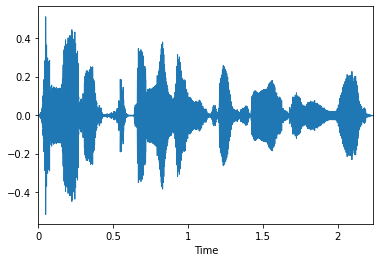

In [ ]:
rec(5, "emotion063-2.wav", "あまり頭がよさそうではない。", "あまりあたまがよさそーでわない。")

デザインも、アーチ型のロゴデザインにより
でざいんも、あーちがたのろごでざいんにより


<IPython.core.display.Javascript object>

---終了---


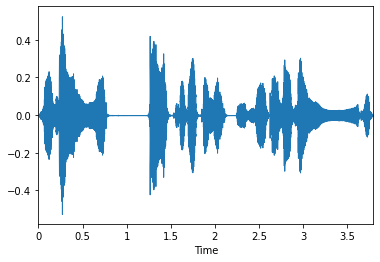

In [ ]:
rec(7, "emotion064-1.wav", "デザインも、アーチ型のロゴデザインにより", "でざいんも、あーちがたのろごでざいんにより")

現代的で登場感、躍動感あるものに仕上げました。
げんだいてきでとーじょーかん、やくどーかんあるものにしあげました。


<IPython.core.display.Javascript object>

---終了---


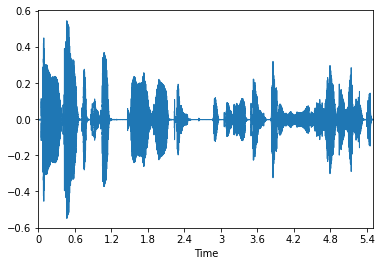

In [ ]:
rec(7, "emotion064-2.wav", "現代的で登場感、躍動感あるものに仕上げました。", "げんだいてきでとーじょーかん、やくどーかんあるものにしあげました。")

そんなに慌てて運転して、一体どこへ行こうってんだよ。
そんなにあわててうんてんして、いったいどこえいこーってんだよ。


<IPython.core.display.Javascript object>

---終了---


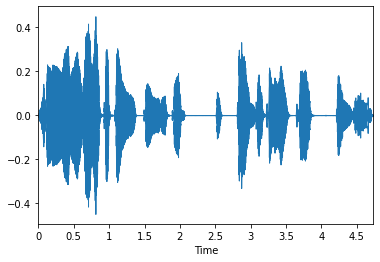

In [ ]:
rec(7, "emotion065.wav", "そんなに慌てて運転して、一体どこへ行こうってんだよ。", "そんなにあわててうんてんして、いったいどこえいこーってんだよ。")

時間はあるんだから、安全運転してくれよ。
じかんわあるんだから、あんぜんうんてんしてくれよ。


<IPython.core.display.Javascript object>

---終了---


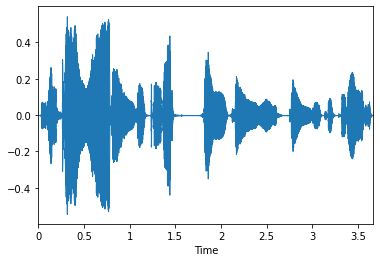

In [ ]:
rec(7, "emotion066.wav", "時間はあるんだから、安全運転してくれよ。", "じかんわあるんだから、あんぜんうんてんしてくれよ。")

ディスプレイはモニタともいい、コンピュータなどの機器から出力される静止画
でぃすぷれいわもにたともいい、こんぴゅーたなどのききからしゅつりょくされるせーしが


<IPython.core.display.Javascript object>

---終了---


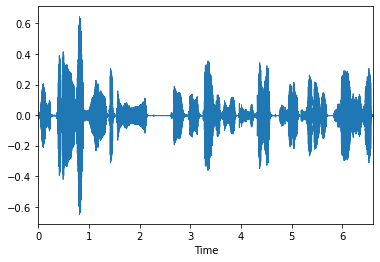

In [ ]:
rec(10, "emotion067-1.wav", "ディスプレイはモニタともいい、コンピュータなどの機器から出力される静止画", "でぃすぷれいわもにたともいい、こんぴゅーたなどのききからしゅつりょくされるせーしが")

または動画の映像信号を表示する機器である。
またわどーがのえーぞーしんごーをひょーじするききである。


<IPython.core.display.Javascript object>

---終了---


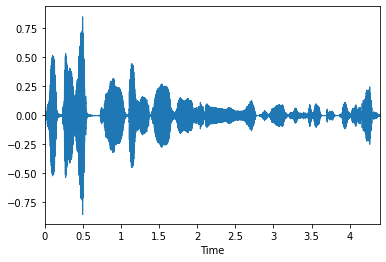

In [ ]:
rec(7, "emotion067-2.wav", "または動画の映像信号を表示する機器である。", "またわどーがのえーぞーしんごーをひょーじするききである。")

撃ち合いが少し静まったとき、パパが走ってフラットに行って
うちあいがすこししずまったとき、ぱぱがはしってふらっとにいって


<IPython.core.display.Javascript object>

---終了---


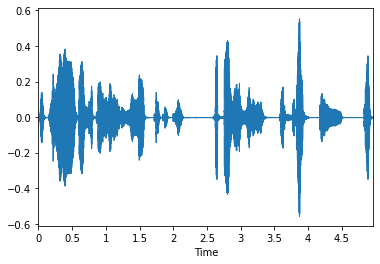

In [ ]:
rec(7, "emotion068-1.wav", "撃ち合いが少し静まったとき、パパが走ってフラットに行って", "うちあいがすこししずまったとき、ぱぱがはしってふらっとにいって")

私たちにサンドイッチを持ってきてくれたわ。
わたしたちにさんどいっちをもってきてくれたわ。


<IPython.core.display.Javascript object>

---終了---


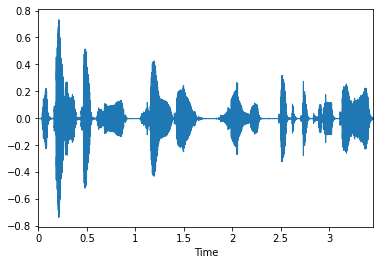

In [ ]:
rec(5, "emotion068-2.wav", "私たちにサンドイッチを持ってきてくれたわ。", "わたしたちにさんどいっちをもってきてくれたわ。")

ギリシャのフットボールの試合では、一方のチームの選手は
ぎりしゃのふっとぼーるのしあいでわ、いっぽーのちーむのせんしゅわ


<IPython.core.display.Javascript object>

---終了---


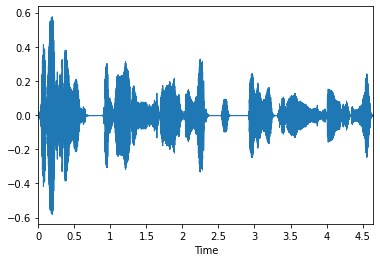

In [ ]:
rec(7, "emotion069-1.wav", "ギリシャのフットボールの試合では、一方のチームの選手は", "ぎりしゃのふっとぼーるのしあいでわ、いっぽーのちーむのせんしゅわ")

相手チームの陣地のラインの向こう側にボールを持ち込もうとしたのです。
あいてちーむのじんちのらいんのむこーがわにぼーるをもちこもーとしたのです。


<IPython.core.display.Javascript object>

---終了---


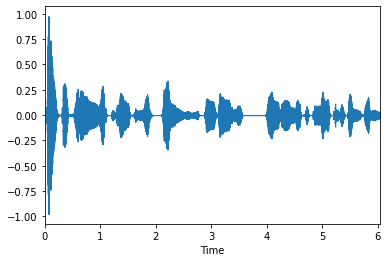

In [ ]:
rec(10, "emotion069-2.wav", "相手チームの陣地のラインの向こう側にボールを持ち込もうとしたのです。", "あいてちーむのじんちのらいんのむこーがわにぼーるをもちこもーとしたのです。")

泳者のシンディー・ニコラスは、へとへとになって泳ぎ切った後、ドーバーでかろうじて陸に上がってきたが
えーしゃのしんでぃーにこらすわ、へとへとになっておよぎきったあと、どーばーでかろーじてりくにあがってきたが


<IPython.core.display.Javascript object>

---終了---


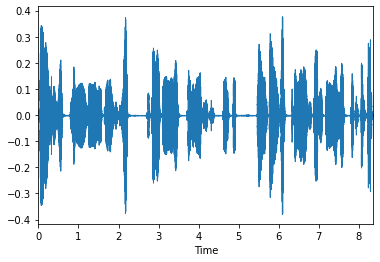

In [ ]:
rec(10, "emotion070-1.wav", "泳者のシンディー・ニコラスは、へとへとになって泳ぎ切った後、ドーバーでかろうじて陸に上がってきたが", "えーしゃのしんでぃーにこらすわ、へとへとになっておよぎきったあと、どーばーでかろーじてりくにあがってきたが")

海峡水泳協会のスポークスマンは、彼女がとても元気であると発表した。
かいきょーすいえーきょーかいのすぽーくすまんわ、かのじょがとてもげんきであるとはっぴょーした。


<IPython.core.display.Javascript object>

---終了---


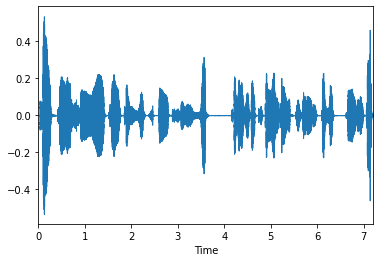

In [ ]:
rec(10, "emotion070-2.wav", "海峡水泳協会のスポークスマンは、彼女がとても元気であると発表した。", "かいきょーすいえーきょーかいのすぽーくすまんわ、かのじょがとてもげんきであるとはっぴょーした。")

若い男女が人里離れた洋館で恐怖の一夜を過ごすという、ホラーの定番スタイルだ。
わかいだんじょがひとざとはなれたよーかんできょーふのいちやをすごすとゆう、ほらーのてーばんすたいるだ。


<IPython.core.display.Javascript object>

---終了---


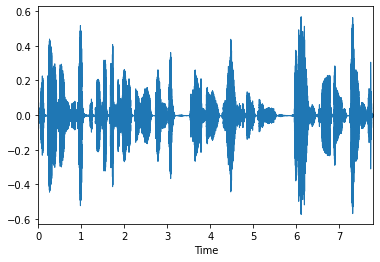

In [ ]:
rec(10, "emotion071.wav", "若い男女が人里離れた洋館で恐怖の一夜を過ごすという、ホラーの定番スタイルだ。", "わかいだんじょがひとざとはなれたよーかんできょーふのいちやをすごすとゆう、ほらーのてーばんすたいるだ。")

一つには、西洋人ではない人々が自分たち独自の文化に誇りを持ち始めてきたためと、また一つには、
ひとつにわ、せーよーじんでわないひとびとがじぶんたちどくじのぶんかにほこりをもちはじめてきたためと、またひとつにわ


<IPython.core.display.Javascript object>

---終了---


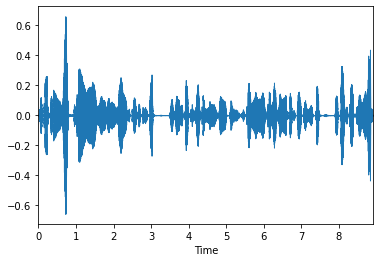

In [ ]:
rec(10, "emotion072-1.wav", "一つには、西洋人ではない人々が自分たち独自の文化に誇りを持ち始めてきたためと、また一つには、", "ひとつにわ、せーよーじんでわないひとびとがじぶんたちどくじのぶんかにほこりをもちはじめてきたためと、またひとつにわ")

フォークを使わないそれらの地域は最も高い出生率の地域を抱えているという理由から、このことは当たっている。
ふぉーくをつかわないそれらのちいきわもっともたかいしゅっしょーりつのちいきをかかえているとゆうりゆうから、このことわあたっている。


<IPython.core.display.Javascript object>

---終了---


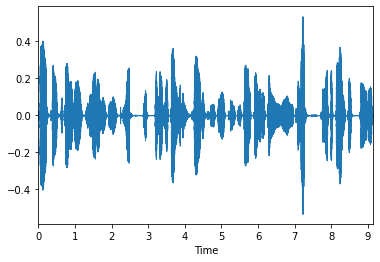

In [ ]:
rec(10, "emotion072-2.wav", "フォークを使わないそれらの地域は最も高い出生率の地域を抱えているという理由から、このことは当たっている。", "ふぉーくをつかわないそれらのちいきわもっともたかいしゅっしょーりつのちいきをかかえているとゆうりゆうから、このことわあたっている。")

私たちは恐怖の中で生きていて、苦しんでいるの。
わたしたちわきょーふのなかでいきていて、くるしんでいるの。


<IPython.core.display.Javascript object>

---終了---


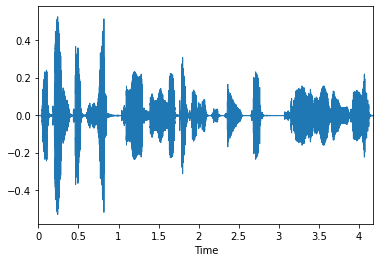

In [ ]:
rec(7, "emotion073.wav", "私たちは恐怖の中で生きていて、苦しんでいるの。", "わたしたちわきょーふのなかでいきていて、くるしんでいるの。")

太陽も花も楽しめないし、私たちの子供時代も楽しめないのよ。
たいよーもはなもたのしめないし、わたしたちのこどもじだいもたのしめないのよ。


<IPython.core.display.Javascript object>

---終了---


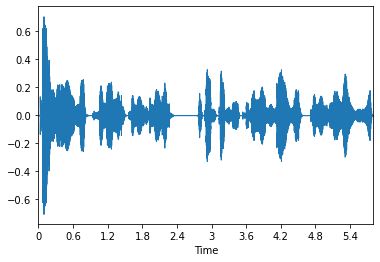

In [ ]:
rec(10, "emotion074.wav", "太陽も花も楽しめないし、私たちの子供時代も楽しめないのよ。", "たいよーもはなもたのしめないし、わたしたちのこどもじだいもたのしめないのよ。")

弊社のエンジニアが日本国内で販売されている同様の製品と仕様を比較した結果
へーしゃのえんじにあがにほんこくないではんばいされているどーよーのせーひんとしよーをひかくしたけっか


<IPython.core.display.Javascript object>

---終了---


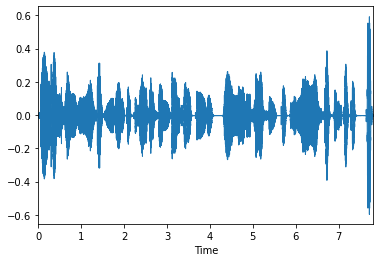

In [ ]:
rec(10, "emotion075-1.wav", "弊社のエンジニアが日本国内で販売されている同様の製品と仕様を比較した結果", "へーしゃのえんじにあがにほんこくないではんばいされているどーよーのせーひんとしよーをひかくしたけっか")

非常に競合力があると判断いたしました。
ひじょーにきょーごーりょくがあるとはんだんいたしました。


<IPython.core.display.Javascript object>

---終了---


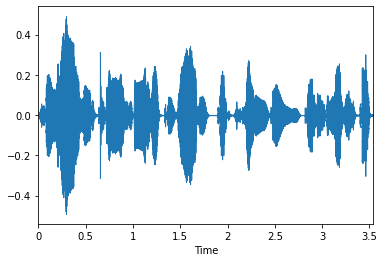

In [ ]:
rec(7, "emotion075-2.wav", "非常に競合力があると判断いたしました。", "ひじょーにきょーごーりょくがあるとはんだんいたしました。")

ノースウエスタン大学の研究者、アイリーン・ペパーバーグは
のーすうえすたんだいがくのけんきゅうしゃ、あいりーんぺぱーばーぐわ


<IPython.core.display.Javascript object>

---終了---


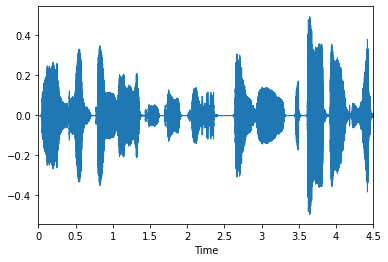

In [ ]:
rec(7, "emotion076-1.wav", "ノースウエスタン大学の研究者、アイリーン・ペパーバーグは", "のーすうえすたんだいがくのけんきゅうしゃ、あいりーんぺぱーばーぐわ")

オウムは人の口まねをするだけでなく言葉の意味を学ぶことができることを発見しつつある。
おーむわひとのくちまねをするだけでなくことばのいみをまなぶことができることをはっけんしつつある。


<IPython.core.display.Javascript object>

---終了---


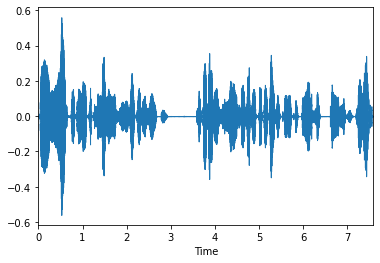

In [ ]:
rec(10, "emotion076-2.wav", "オウムは人の口まねをするだけでなく言葉の意味を学ぶことができることを発見しつつある。", "おーむわひとのくちまねをするだけでなくことばのいみをまなぶことができることをはっけんしつつある。")

名前をテョといいます。
なまえをてょといいます。


<IPython.core.display.Javascript object>

---終了---


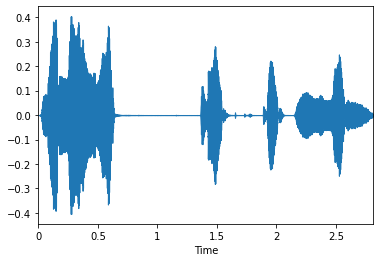

In [ ]:
rec(5, "emotion077.wav", "名前をテョといいます。", "なまえをてょといいます。")

ぴゅうぴゅう風が吹きこんでくる。
ぴゅうぴゅうかぜがふきこんでくる。


<IPython.core.display.Javascript object>

---終了---


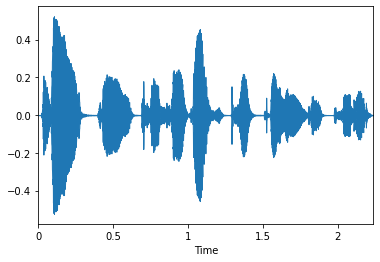

In [ ]:
rec(5, "emotion078.wav", "ぴゅうぴゅう風が吹きこんでくる。", "ぴゅうぴゅうかぜがふきこんでくる。")

キェー。ギェー。イェーイ。
きぇー。ぎぇー。いぇーい。


<IPython.core.display.Javascript object>

---終了---


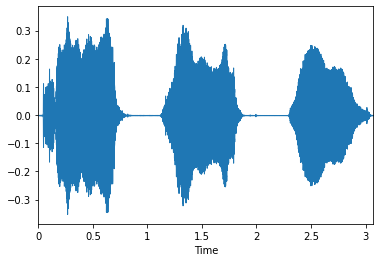

In [ ]:
rec(5, "emotion079.wav", "キェー。ギェー。イェーイ。", "きぇー。ぎぇー。いぇーい。")

In [ ]:
rec(5, "emotion080.wav", "ひぇーん。びぇーん。ぴぇーん。", "ひぇーん。びぇーん。ぴぇーん。")

ひぇーん。びぇーん。ぴぇーん。
ひぇーん。びぇーん。ぴぇーん。


<IPython.core.display.Javascript object>

---終了---


In [ ]:
rec(5, "emotion081.wav", "プリミェー。ミェルン。ニェン。", "ぷりみぇー。みぇるん。にぇん。")

ステューデント。ダブルデュアル。
すてゅーでんと。だぶるでゅある。


<IPython.core.display.Javascript object>

---終了---


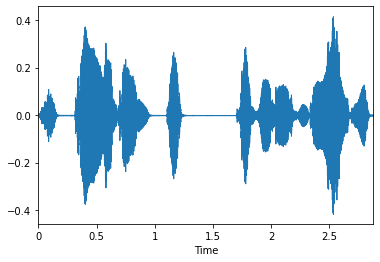

In [ ]:
rec(5, "emotion082.wav", "ステューデント。ダブルデュアル。", "すてゅーでんと。だぶるでゅある。")

エテュード。エデュケーショナル。サブスティテューション。
えてゅーど。えでゅけーしょなる。さぶすてぃてゅーしょん。


<IPython.core.display.Javascript object>

---終了---


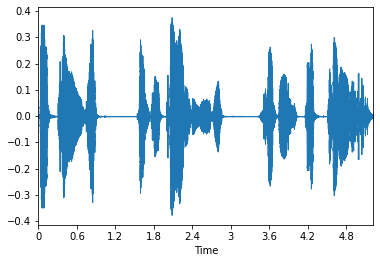

In [ ]:
rec(7, "emotion083.wav", "エテュード。エデュケーショナル。サブスティテューション。", "えてゅーど。えでゅけーしょなる。さぶすてぃてゅーしょん。")

ジャデャクシュ。
じゃでゃくしゅ。


<IPython.core.display.Javascript object>

---終了---


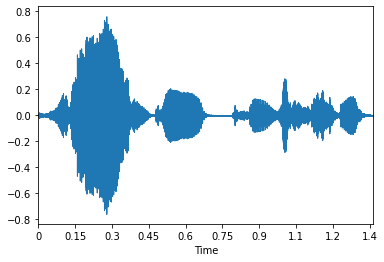

In [ ]:
rec(3, "emotion084.wav", "ジャデャクシュ。", "じゃでゃくしゅ。")

ブレンドデョート。
ぶれんどでょーと。


<IPython.core.display.Javascript object>

---終了---


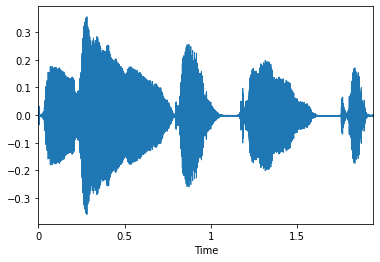

In [ ]:
rec(3, "emotion085.wav", "ブレンドデョート。", "ぶれんどでょーと。")

イデュスルファーゼ。
いでゅするふぁーぜ。


<IPython.core.display.Javascript object>

---終了---


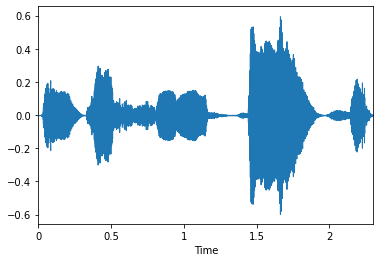

In [ ]:
rec(5, "emotion086.wav", "イデュスルファーゼ。", "いでゅするふぁーぜ。")

あっあの。
あっあの。


<IPython.core.display.Javascript object>

---終了---


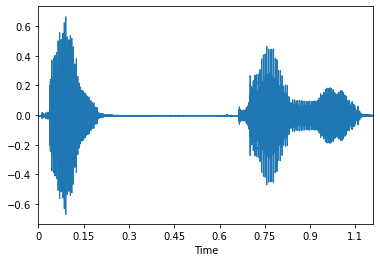

In [ ]:
rec(3, "emotion087.wav", "あっあの。", "あっあの。")

いっいえ。
いっいえ。


<IPython.core.display.Javascript object>

---終了---


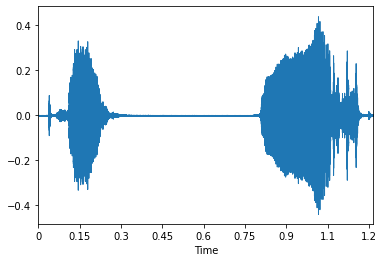

In [ ]:
rec(3, "emotion088.wav", "いっいえ。", "いっいえ。")

えっえぇ。
えっえぇ。


<IPython.core.display.Javascript object>

---終了---


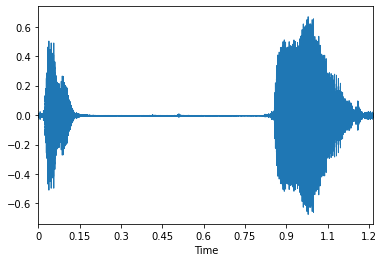

In [ ]:
rec(3, "emotion089.wav", "えっえぇ。", "えっえぇ。")

おっおい。
おっおい。


<IPython.core.display.Javascript object>

---終了---


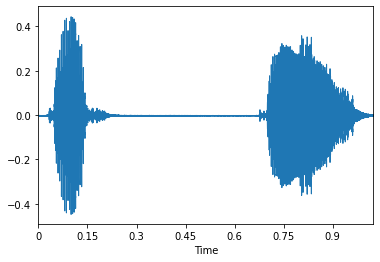

In [ ]:
rec(3, "emotion090.wav", "おっおい。", "おっおい。")

んーとね。
んーとね。


<IPython.core.display.Javascript object>

---終了---


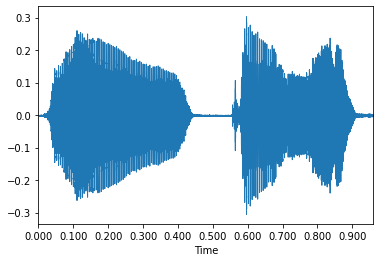

In [ ]:
rec(3, "emotion091.wav", "んーとね。", "んーとね。")

アンツィオ。
あんつぃお。


<IPython.core.display.Javascript object>

---終了---


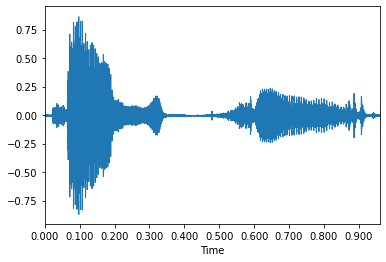

In [ ]:
rec(3, "emotion092.wav", "アンツィオ。", "あんつぃお。")

エンツォ。
えんつぉ。


<IPython.core.display.Javascript object>

---終了---


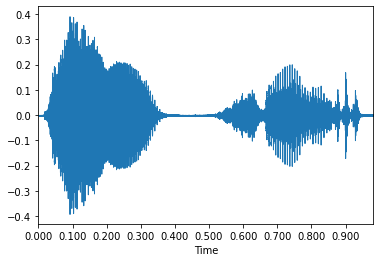

In [ ]:
rec(3, "emotion093.wav", "エンツォ。", "えんつぉ。")

カートゥーン。
かーとぅーん。


<IPython.core.display.Javascript object>

---終了---


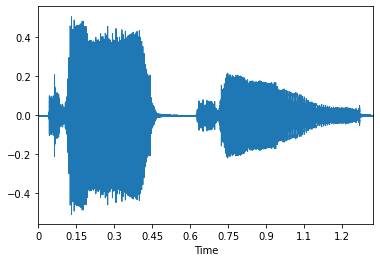

In [ ]:
rec(3, "emotion094.wav", "カートゥーン。", "かーとぅーん。")

スィーディー。
すぃーでぃー。


<IPython.core.display.Javascript object>

---終了---


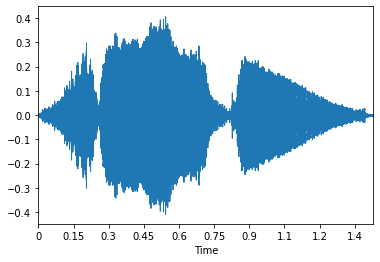

In [ ]:
rec(3, "emotion095.wav", "スィーディー。", "すぃーでぃー。")

ズィーブラ。
ずぃーぶら。


<IPython.core.display.Javascript object>

---終了---


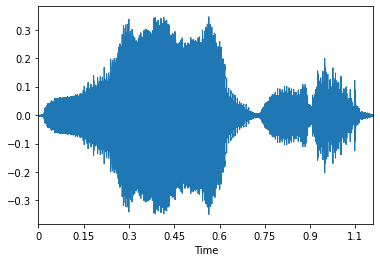

In [ ]:
rec(3, "emotion096.wav", "ズィーブラ。", "ずぃーぶら。")

デピュティーガバナー。
でぴゅてぃーがばなー。


<IPython.core.display.Javascript object>

---終了---


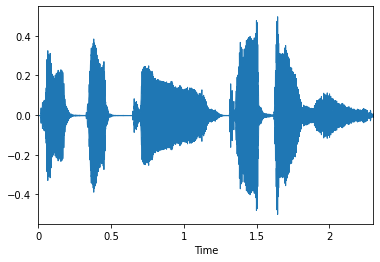

In [ ]:
rec(5, "emotion097.wav", "デピュティーガバナー。", "でぴゅてぃーがばなー。")

エリュシオン。
えりゅしおん。


<IPython.core.display.Javascript object>

---終了---


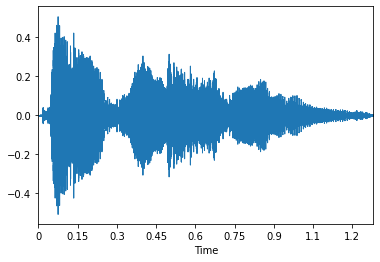

In [214]:
rec(3, "emotion098.wav", "エリュシオン。", "えりゅしおん。")

ガリェント。
がりぇんと。


<IPython.core.display.Javascript object>

---終了---


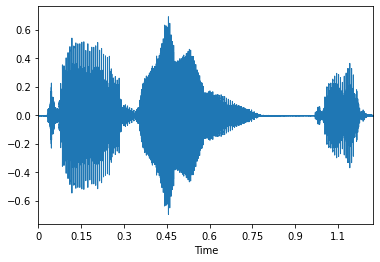

In [215]:
rec(3, "emotion099.wav", "ガリェント。", "がりぇんと。")

ラーテャン。
らーてゃん。


<IPython.core.display.Javascript object>

---終了---


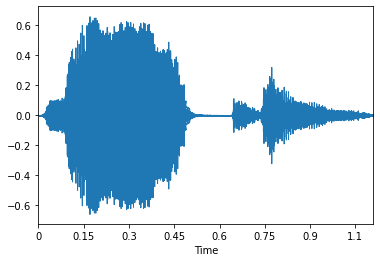

In [216]:
rec(3, "emotion100.wav", "ラーテャン。", "らーてゃん。")